In [1]:
# from ucimlrepo import fetch_ucirepo 
  
# # fetch dataset 
# diabetes_130_us_hospitals_for_years_1999_2008 = fetch_ucirepo(id=296) 
  
# # data (as pandas dataframes) 
# X = diabetes_130_us_hospitals_for_years_1999_2008.data.features 
# y = diabetes_130_us_hospitals_for_years_1999_2008.data.targets 
  
# # metadata 
# print(diabetes_130_us_hospitals_for_years_1999_2008.metadata) 
  
# # variable information 
# print(diabetes_130_us_hospitals_for_years_1999_2008.variables) 


### Please disregard the above data loading practices, since we would be examining the accuracy of our prediction, we would split our data instead of only examining features and target results.

In [1]:
# Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import re

## Exploring Data

In [2]:
# load data
df = pd.read_csv("diabetic_data.csv")
admission_type_code = pd.read_csv("IDS_mapping.csv", nrows=8)
discharge_disposition_code = pd.read_csv("IDS_mapping.csv", skiprows=10, nrows=30)
admission_source_code = pd.read_csv("IDS_mapping.csv", skiprows=42)

In [3]:
admission_type_code

,admission_type_id,description
0,1,Emergency
1,2,Urgent
2,3,Elective
3,4,Newborn
4,5,Not Available
5,6,NaN
6,7,Trauma Center
7,8,Not Mapped


In [4]:
discharge_disposition_code.to_csv("discharge_disposition_code.csv", index=False)
discharge_disposition_code

,discharge_disposition_id,description
0,1,Discharged to home
1,2,Discharged/transferred to another short term h...
2,3,Discharged/transferred to SNF
3,4,Discharged/transferred to ICF
4,5,Discharged/transferred to another type of inpa...
5,6,Discharged/transferred to home with home healt...
6,7,Left AMA
7,8,Discharged/transferred to home under care of H...
8,9,Admitted as an inpatient to this hospital
9,10,Neonate discharged to another hospital for neo...


In [5]:
admission_source_code.to_csv("admission_source_code.csv", index=False)
admission_source_code

,admission_source_id,description
0,1,Physician Referral
1,2,Clinic Referral
2,3,HMO Referral
3,4,Transfer from a hospital
4,5,Transfer from a Skilled Nursing Facility (SNF)
5,6,Transfer from another health care facility
6,7,Emergency Room
7,8,Court/Law Enforcement
8,9,Not Available
9,10,Transfer from critial access hospital


In [6]:
df.dtypes

encounter_id                 int64
patient_nbr                  int64
race                        object
gender                      object
age                         object
weight                      object
admission_type_id            int64
discharge_disposition_id     int64
admission_source_id          int64
time_in_hospital             int64
payer_code                  object
medical_specialty           object
num_lab_procedures           int64
num_procedures               int64
num_medications              int64
number_outpatient            int64
number_emergency             int64
number_inpatient             int64
diag_1                      object
diag_2                      object
diag_3                      object
number_diagnoses             int64
max_glu_serum               object
A1Cresult                   object
metformin                   object
repaglinide                 object
nateglinide                 object
chlorpropamide              object
glimepiride         

In [7]:
# Check for NAs and Remove unnecessary columns
df.isna().sum()

encounter_id                    0
patient_nbr                     0
race                            0
gender                          0
age                             0
weight                          0
admission_type_id               0
discharge_disposition_id        0
admission_source_id             0
time_in_hospital                0
payer_code                      0
medical_specialty               0
num_lab_procedures              0
num_procedures                  0
num_medications                 0
number_outpatient               0
number_emergency                0
number_inpatient                0
diag_1                          0
diag_2                          0
diag_3                          0
number_diagnoses                0
max_glu_serum               96420
A1Cresult                   84748
metformin                       0
repaglinide                     0
nateglinide                     0
chlorpropamide                  0
glimepiride                     0
acetohexamide 

## Data Cleaning & Preprocessing

In [8]:
# Check if there's "?"
has_question_mark = (df == "?").any().any()
print(has_question_mark)  # Returns True if any value is "?", False otherwise
columns_with_qmark = df.columns[(df == "?").any()]
print(columns_with_qmark)  # Lists columns that have "?"
# Replace them with NA
df.replace("?", pd.NA, inplace=True)

# Check if there's "Unknown/Invalid"
has_unknown = (df == "Unknown/Invalid").any().any()
print(has_unknown)
columns_with_unknown = df.columns[(df == "Unknown/Invalid").any()]
print(columns_with_unknown)  # Lists columns that have "?"
# Replace them with NA
df.replace("Unknown/Invalid", pd.NA, inplace=True)

# Check number of nas again
df.isna().sum()

True
Index(['race', 'weight', 'payer_code', 'medical_specialty', 'diag_1', 'diag_2',
       'diag_3'],
      dtype='object')
True
Index(['gender'], dtype='object')


encounter_id                    0
patient_nbr                     0
race                         2273
gender                          3
age                             0
weight                      98569
admission_type_id               0
discharge_disposition_id        0
admission_source_id             0
time_in_hospital                0
payer_code                  40256
medical_specialty           49949
num_lab_procedures              0
num_procedures                  0
num_medications                 0
number_outpatient               0
number_emergency                0
number_inpatient                0
diag_1                         21
diag_2                        358
diag_3                       1423
number_diagnoses                0
max_glu_serum               96420
A1Cresult                   84748
metformin                       0
repaglinide                     0
nateglinide                     0
chlorpropamide                  0
glimepiride                     0
acetohexamide 

In [9]:
# Convert the three ids (categorical dummies) from int to category objects
df["admission_type_id"] = df["admission_type_id"].astype("category")
df["discharge_disposition_id"] = df["discharge_disposition_id"].astype("category")
df["admission_source_id"] = df["admission_source_id"].astype("category")
print(df.dtypes)

encounter_id                   int64
patient_nbr                    int64
race                          object
gender                        object
age                           object
weight                        object
admission_type_id           category
discharge_disposition_id    category
admission_source_id         category
time_in_hospital               int64
payer_code                    object
medical_specialty             object
num_lab_procedures             int64
num_procedures                 int64
num_medications                int64
number_outpatient              int64
number_emergency               int64
number_inpatient               int64
diag_1                        object
diag_2                        object
diag_3                        object
number_diagnoses               int64
max_glu_serum                 object
A1Cresult                     object
metformin                     object
repaglinide                   object
nateglinide                   object
c

In [10]:
# Checking value counts within each column
for cols in df.columns:
    print(df[cols].value_counts())

encounter_id
2278392      1
190792044    1
190790070    1
190789722    1
190786806    1
            ..
106665324    1
106657776    1
106644876    1
106644474    1
443867222    1
Name: count, Length: 101766, dtype: int64
patient_nbr
88785891     40
43140906     28
1660293      23
88227540     23
23199021     23
             ..
11005362      1
98252496      1
1019673       1
13396320      1
175429310     1
Name: count, Length: 71518, dtype: int64
race
Caucasian          76099
AfricanAmerican    19210
Hispanic            2037
Other               1506
Asian                641
Name: count, dtype: int64
gender
Female    54708
Male      47055
Name: count, dtype: int64
age
[70-80)     26068
[60-70)     22483
[50-60)     17256
[80-90)     17197
[40-50)      9685
[30-40)      3775
[90-100)     2793
[20-30)      1657
[10-20)       691
[0-10)        161
Name: count, dtype: int64
weight
[75-100)     1336
[50-75)       897
[100-125)     625
[125-150)     145
[25-50)        97
[0-25)         48
[150-

In [11]:
df.columns

Index(['encounter_id', 'patient_nbr', 'race', 'gender', 'age', 'weight',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id',
       'time_in_hospital', 'payer_code', 'medical_specialty',
       'num_lab_procedures', 'num_procedures', 'num_medications',
       'number_outpatient', 'number_emergency', 'number_inpatient', 'diag_1',
       'diag_2', 'diag_3', 'number_diagnoses', 'max_glu_serum', 'A1Cresult',
       'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide',
       'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

In [12]:
# Removing encounter_id as it could represent the same patient with different ids
# delete columns "diag_2", "diag_3", only use the primary diagnosis(diag_1)
# Removing columns with too much missing data:
    # “Weight” is missing in over 98% records. “Payer code” and “Medical specialty” 
    # also have 40-50% missing values. The best thing is to drop them because the 
    # poor interpretability and little predictive generalizability to patients.'
    # max_glu_serum               96420 missing
    # A1Cresult                   84748 missing
# Three medications named “Citoglipton”, "metformin-rosiglitazone" and “Examide” were deleted 
    # because all records have the same value "no".
# Also removing target variable since this is used for X
columns_to_exclude = ["encounter_id", "weight", "payer_code",
                      "medical_specialty", "examide", "citoglipton",
                      "max_glu_serum", "A1Cresult", "metformin-rosiglitazone"]

new_df = df.drop(columns=columns_to_exclude)

# Checking the rest of the NAs
new_df.isna().sum()

# Removing the rest of the NAs since it's all categorical data thus basically unable to fill them
clean_df = new_df.copy()
clean_df = clean_df.dropna()
clean_df

,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,...,troglitazone,tolazamide,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
1,55629189,Caucasian,Female,[10-20),1,1,7,3,59,0,...,No,No,Up,No,No,No,No,Ch,Yes,>30
2,86047875,AfricanAmerican,Female,[20-30),1,1,7,2,11,5,...,No,No,No,No,No,No,No,No,Yes,NO
3,82442376,Caucasian,Male,[30-40),1,1,7,2,44,1,...,No,No,Up,No,No,No,No,Ch,Yes,NO
4,42519267,Caucasian,Male,[40-50),1,1,7,1,51,0,...,No,No,Steady,No,No,No,No,Ch,Yes,NO
5,82637451,Caucasian,Male,[50-60),2,1,2,3,31,6,...,No,No,Steady,No,No,No,No,No,Yes,>30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,100162476,AfricanAmerican,Male,[70-80),1,3,7,3,51,0,...,No,No,Down,No,No,No,No,Ch,Yes,>30
101762,74694222,AfricanAmerican,Female,[80-90),1,4,5,5,33,3,...,No,No,Steady,No,No,No,No,No,Yes,NO
101763,41088789,Caucasian,Male,[70-80),1,1,7,1,53,0,...,No,No,Down,No,No,No,No,Ch,Yes,NO
101764,31693671,Caucasian,Female,[80-90),2,3,7,10,45,2,...,No,No,Up,No,No,No,No,Ch,Yes,NO


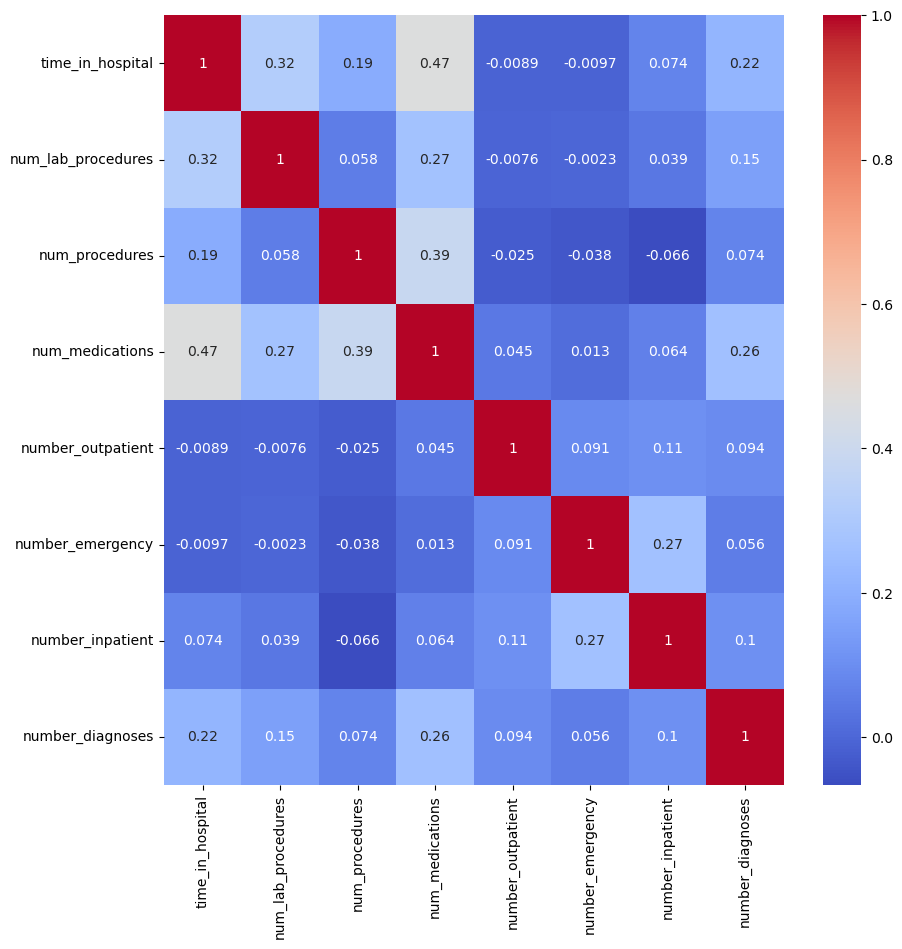

In [13]:
# Correlation between numerical features
num_col = ['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications',
          'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']

# time_in_hospital and num_medication are relatively higher correlated, which makes sense,
# the more time you stayed in the hospital, the more medication would be used on you
# If conducting regression related analysis, need to be careful with multicollinearity

corr_matrix = df[num_col].corr()
plt.figure(figsize=(10, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()

In [14]:
# Observing discharge disposition code to see if anything can be simplified
for i in range(0, 30):
    print(discharge_disposition_code.iloc[i]['discharge_disposition_id'], discharge_disposition_code.iloc[i]['description'])

1 Discharged to home
2 Discharged/transferred to another short term hospital
3 Discharged/transferred to SNF
4 Discharged/transferred to ICF
5 Discharged/transferred to another type of inpatient care institution
6 Discharged/transferred to home with home health service
7 Left AMA
8 Discharged/transferred to home under care of Home IV provider
9 Admitted as an inpatient to this hospital
10 Neonate discharged to another hospital for neonatal aftercare
11 Expired
12 Still patient or expected to return for outpatient services
13 Hospice / home
14 Hospice / medical facility
15 Discharged/transferred within this institution to Medicare approved swing bed
16 Discharged/transferred/referred another institution for outpatient services
17 Discharged/transferred/referred to this institution for outpatient services
18 nan
19 Expired at home. Medicaid only, hospice.
20 Expired in a medical facility. Medicaid only, hospice.
21 Expired, place unknown. Medicaid only, hospice.
22 Discharged/transferred

Basing on some common sense: Since the objective is to predict readmissions, those patients who died during this hospital admission were excluded. Encounters with “Discharge disposition” values of 11, 13, 14, 19, 20, or 21 are related to death or hospice which mean these patients cannot be readmitted.

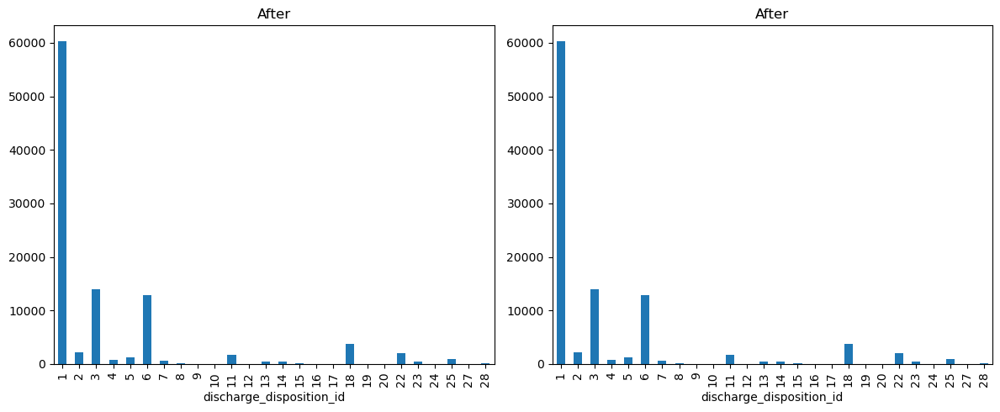

In [15]:
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1) 
df["discharge_disposition_id"].value_counts().sort_index().plot(kind="bar")
plt.title("After")

remove_values = [11, 13, 14, 19, 20, 21]
clean_df = clean_df[~clean_df["discharge_disposition_id"].isin(remove_values)]

plt.subplot(1, 2, 2)
df["discharge_disposition_id"].value_counts().sort_index().plot(kind="bar")
plt.title("After")

plt.tight_layout()
plt.show()

For reducing complexity, reducing dimension of the admission_type_id from 8 types to 4 types
- Combine Emergency, Urgent, and Trauma Center into a single category (e.g., "Urgent/Emergency").
- Combine Not Available, Not Mapped, and NaN into a single category (e.g., "Unknown").
- Keep Elective and Newborn separate if they hold distinct importance.

admission_type
Urgent/Emergency    67806
Elective            17998
Unknown              9858
Newborn                10
Name: count, dtype: int64


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/220767919.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_df["admission_type"] = clean_df["admission_type_id"].map(admission_mapping)
/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/220767919.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_df["admission_type"] = clean_df["admission_type"].astype("category")


Text(0.5, 1.0, 'Admission Type')

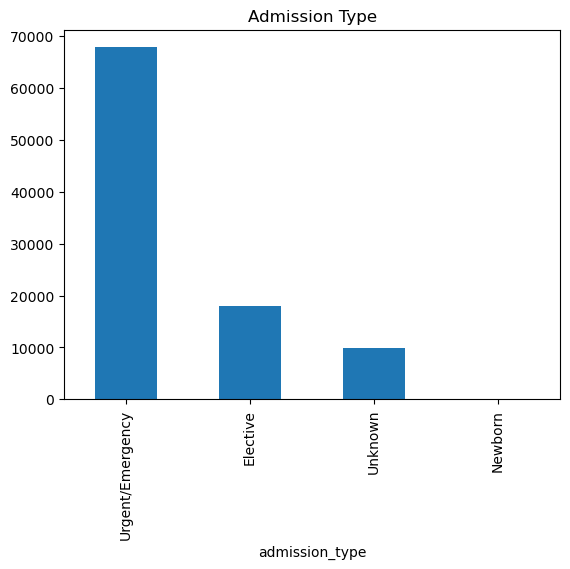

In [16]:
# Define mapping for simplification
admission_mapping = {
    1: "Urgent/Emergency",  # Emergency
    2: "Urgent/Emergency",  # Urgent
    3: "Elective",
    4: "Newborn",
    5: "Unknown",  # Not Available
    6: "Unknown",  # NaN cases will be handled separately
    7: "Urgent/Emergency",  # Trauma Center
    8: "Unknown"  # Not Mapped
}

# Apply mapping
clean_df["admission_type"] = clean_df["admission_type_id"].map(admission_mapping)
clean_df["admission_type"] = clean_df["admission_type"].astype("category")
print(clean_df.admission_type.value_counts())
clean_df.admission_type.value_counts().plot(kind="bar")
plt.title("Admission Type")

admission_sources
Emergency               54333
Referral-Based          29150
Other/Unknown            6555
Transferred              5570
Legal/Social Service       64
Name: count, dtype: int64


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/4271516002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_df["admission_sources"] = clean_df["admission_source_id"].map(admission_source_mapping_by_id)
/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/4271516002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clean_df["admission_sources"] = clean_df["admission_sources"].astype("category")


Text(0.5, 1.0, 'Admission Sources')

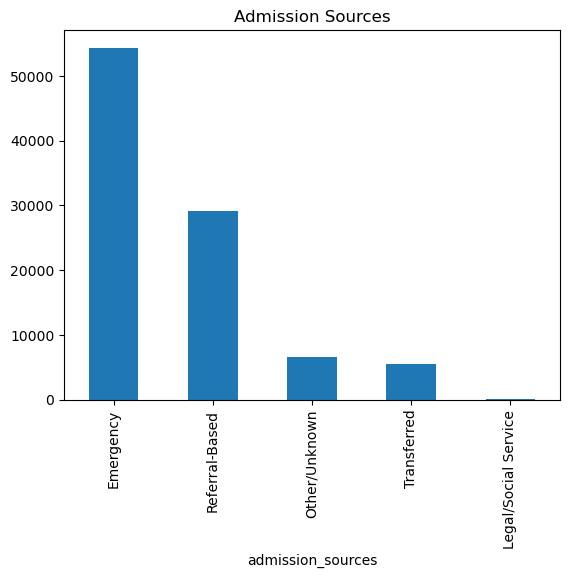

In [17]:
# Mapping admission_source_id
admission_source_mapping_by_id = {
    1: "Referral-Based",  # Physician, Clinic, HMO Referral
    2: "Referral-Based",  
    3: "Referral-Based",  
    4: "Transferred",  # Transfers from hospital, SNF, healthcare facilities
    5: "Transferred",
    6: "Transferred",
    10: "Transferred",
    18: "Transferred",
    22: "Transferred",
    25: "Transferred",
    7: "Emergency",  # Emergency Room Admission
    8: "Legal/Social Service",  # Court/Law Enforcement, Social Services
    9: "Legal/Social Service",
    13: "Legal/Social Service",
    11: "Other/Unknown",  # Miscellaneous or unknown sources
    12: "Other/Unknown",
    14: "Other/Unknown",
    15: "Other/Unknown",
    16: "Other/Unknown",
    17: "Other/Unknown",
    19: "Other/Unknown",
    20: "Other/Unknown",
    21: "Other/Unknown",
    23: "Other/Unknown",
    24: "Other/Unknown",
    26: "Other/Unknown"
}

# Apply mapping
clean_df["admission_sources"] = clean_df["admission_source_id"].map(admission_source_mapping_by_id)
clean_df["admission_sources"] = clean_df["admission_sources"].astype("category")
print(clean_df.admission_sources.value_counts())
clean_df.admission_sources.value_counts().plot(kind="bar")
plt.title("Admission Sources")

In [18]:
# Re-import necessary libraries
import plotly.graph_objects as go

# Define the mappings for admission_type_id
admission_type_mapping = {
    "Emergency/Urgent": [1, 2],  # Emergency and Urgent admissions
    "Elective": [3],  # Elective admissions
    "Newborn": [4],  # Newborn admissions
    "Other/Unknown": [5, 6, 7, 8]  # Not Available, Trauma, and Unmapped cases
}

# Define the mappings for admission_source_id
admission_source_mapping = {
    "Referral-Based": [1, 2, 3],  # Physician, Clinic, HMO Referral
    "Transferred": [4, 5, 6, 10, 18, 22, 25],  # Transfers from hospital, SNF, healthcare facilities
    "Emergency": [7],  # Emergency Room Admission
    "Legal/Social Service": [8, 9, 13],  # Court/Law Enforcement, Social Services
    "Other/Unknown": [11, 12, 14, 15, 16, 17, 19, 20, 21, 23, 24, 26]  # Miscellaneous or unknown sources
}

# Function to generate a Sankey diagram for a given mapping
def create_sankey_chart(mapping, title):
    source = []
    target = []
    value = []

    # Extract mapping relationships for Sankey diagram
    for category, ids in mapping.items():
        for _id in ids:
            source.append(f"ID {_id}")  # Convert ID to string for visualization
            target.append(category)  # Map to larger group
            value.append(1)  # Each ID contributes equally

    # Create a list of unique labels for Sankey nodes
    unique_labels = list(set(source + target))

    # Create a Sankey diagram
    fig = go.Figure(go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=unique_labels,  # Unique labels for all nodes
        ),
        link=dict(
            source=[unique_labels.index(s) for s in source],  # Convert to indices
            target=[unique_labels.index(t) for t in target],  # Convert to indices
            value=value
        )
    ))

    # Update layout
    fig.update_layout(title_text=title, font_size=18, template="plotly_white")

    # Show plot
    fig.show()

# Create Sankey diagrams for admission_type_id and admission_source_id
create_sankey_chart(admission_type_mapping, "Admission Type ID Grouping")
create_sankey_chart(admission_source_mapping, "Sankey Diagram: Admission Source ID Grouping")


discharge_dispositions
Home Discharge    70235
Transferred       19866
Other/Unknown      4979
Left AMA            592
Name: count, dtype: int64


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/4072911757.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/4072911757.py:37: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1.0, 'Discharge Dispositions')

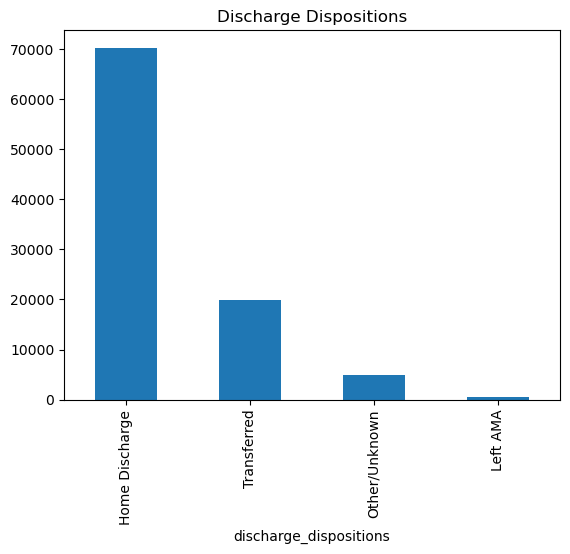

In [19]:
# Mapping discharge disposition id
discharge_disposition_mapping = {
    1: "Home Discharge",  # Home and Home with Health Service
    6: "Home Discharge",
    2: "Transferred",  # Transfers to other healthcare facilities
    3: "Transferred",
    4: "Transferred",
    5: "Transferred",
    22: "Transferred",
    23: "Transferred",
    7: "Left AMA",  # Left against medical advice
    11: "Deceased/Hospice",  # Deceased or Hospice care
    13: "Deceased/Hospice",
    14: "Deceased/Hospice",
    19: "Deceased/Hospice",
    20: "Deceased/Hospice",
    21: "Deceased/Hospice",
    8: "Other/Unknown",  # Miscellaneous cases
    9: "Other/Unknown",
    10: "Other/Unknown",
    12: "Other/Unknown",
    15: "Other/Unknown",
    16: "Other/Unknown",
    17: "Other/Unknown",
    18: "Other/Unknown",
    24: "Other/Unknown",
    25: "Other/Unknown",
    26: "Other/Unknown",
    27: "Other/Unknown",
    28: "Other/Unknown",
    29: "Other/Unknown",
    30: "Other/Unknown"
}
# There won't be deceased and in hospice since we removed them earlier
# Apply mapping
clean_df["discharge_dispositions"] = clean_df["discharge_disposition_id"].map(discharge_disposition_mapping)
clean_df["discharge_dispositions"] = clean_df["discharge_dispositions"].astype("category")
print(clean_df.discharge_dispositions.value_counts())
clean_df.discharge_dispositions.value_counts().plot(kind="bar")
plt.title("Discharge Dispositions")

In [20]:
# Re-import necessary libraries
import plotly.graph_objects as go

# Define the mappings again after reset
discharge_disposition_mapping = {
    "Home Discharge": [1, 6],  
    "Transferred": [2, 3, 4, 5, 22, 23],  
    "Left AMA": [7],  
    "Deceased/Hospice": [11, 13, 14, 19, 20, 21],  
    "Other/Unknown": [8, 9, 10, 12, 15, 16, 17, 18, 24, 25, 26, 27, 28, 29, 30]
}

# Prepare data for the Sankey chart
source = []  # Original discharge_disposition_id values
target = []  # Corresponding larger category
value = []   # Count of occurrences

# Extract mapping relationships for Sankey diagram
for category, ids in discharge_disposition_mapping.items():
    for _id in ids:
        source.append(f"ID {_id}")  # Convert ID to string for visualization
        target.append(category)  # Map to larger group
        value.append(1)  # Each ID contributes equally

# Create a list of unique labels for Sankey nodes
unique_labels = list(set(source + target))

# Create a Sankey diagram
fig = go.Figure(go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=unique_labels,  # Unique labels for all nodes
    ),
    link=dict(
        source=[unique_labels.index(s) for s in source],  # Convert to indices
        target=[unique_labels.index(t) for t in target],  # Convert to indices
        value=value
    )
))

# Update layout
fig.update_layout(title_text="Sankey Diagram: Discharge Disposition ID Grouping", font_size=14, template="plotly_white")

# Show plot
fig.show()


**Decoding diag_1 for better interpretability**
inspired by: https://www.kaggle.com/code/chongchong33/predicting-hospital-readmission-of-diabetics/notebook
Quote:
- "The 'diag_1' contained three diagnoses for a given patient (primary, secondary and additional). However, each of these had 700-900 unique ICD codes and it is extremely difficult to include them in the model and interpret them meaningfully. Therefore, these diagnosis codes were collapsed into 9 disease categories, which include Circulatory, Respiratory, Digestive, Diabetes, Injury, Musculoskeletal, Genitourinary, Neoplasms, and Others (See Table below)"


![Alt text](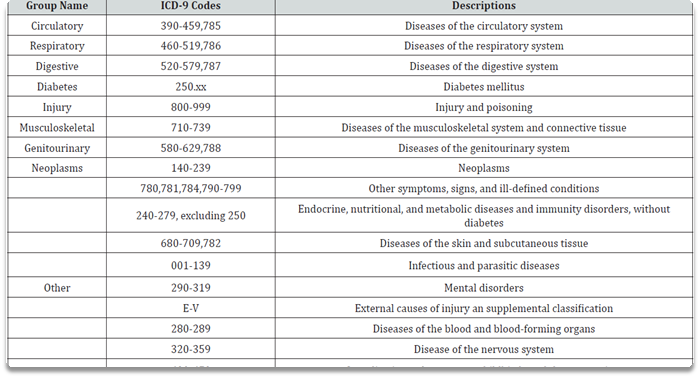 "a title")

In [21]:
clean_df['diag_1'] = clean_df['diag_1'].astype(str)  # Ensure 'diag_1' is a string
clean_df['diag_2'] = clean_df['diag_2'].astype(str)
clean_df['diag_3'] = clean_df['diag_3'].astype(str)

# Define a function to categorize primary diagnosis
def categorize_primary_diagnosis(diag):
    if re.match(r"^[VE]", diag):  # Starts with "V" or "E"
        return "Other"
    elif re.match(r"^250", diag):  # Exactly "250"
        return "Diabetes"
    else:
        try:
            code = int(diag)  # Convert to integer if possible
            if 390 <= code <= 459 or code == 785:
                return "Circulatory"
            elif 460 <= code <= 519 or code == 786:
                return "Respiratory"
            elif 520 <= code <= 579 or code == 787:
                return "Digestive"
            elif 580 <= code <= 629 or code == 788:
                return "Genitourinary"
            elif 140 <= code <= 239:
                return "Neoplasms"
            elif 710 <= code <= 739:
                return "Musculoskeletal"
            elif 800 <= code <= 999:
                return "Injury"
            else:
                return "Other"
        except ValueError:  # If conversion fails (e.g., non-numeric values)
            return "Other"


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/1606712472.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/1606712472.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/1606712472.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

primary_diagnosis_1
Circulatory        28887
Other              17169
Respiratory        13511
Digestive           9045
Diabetes            7870
Injury              6590
Genitourinary       4870
Musculoskeletal     4717
Neoplasms           3013
Name: count, dtype: int64


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/3775061463.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1.0, 'Primary Diagnosis 1')

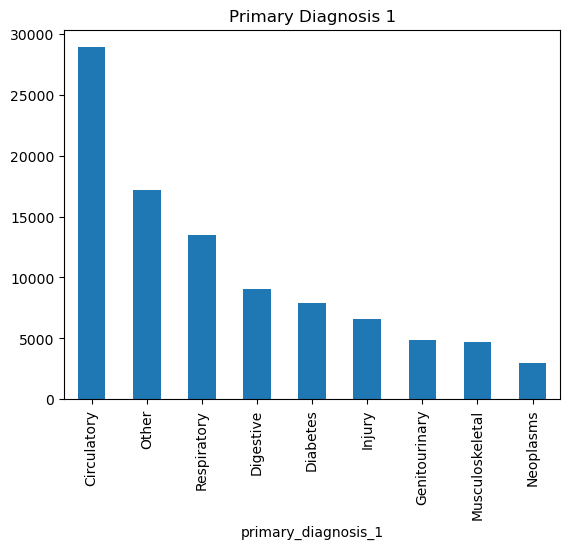

In [22]:
# Apply function to create a new column 'primary_diagnosis'
clean_df['primary_diagnosis_1'] = clean_df['diag_1'].apply(categorize_primary_diagnosis)
print(clean_df.primary_diagnosis_1.value_counts())
clean_df.primary_diagnosis_1.value_counts().plot(kind="bar")
plt.title("Primary Diagnosis 1")


primary_diagnosis_2
Circulatory        30397
Other              25148
Diabetes           11776
Respiratory        10140
Genitourinary       7977
Digestive           3967
Injury              2286
Neoplasms           2274
Musculoskeletal     1707
Name: count, dtype: int64


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/1250607312.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1.0, 'Primary Diagnosis 2')

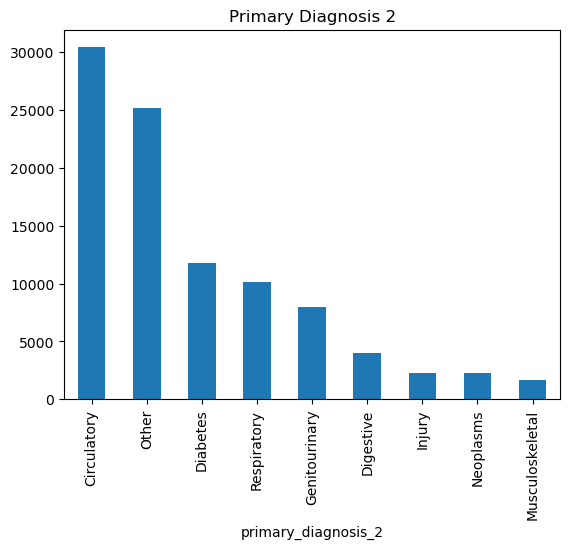

In [25]:

clean_df['primary_diagnosis_2'] = clean_df['diag_2'].apply(categorize_primary_diagnosis)
print(clean_df.primary_diagnosis_2.value_counts())
clean_df.primary_diagnosis_2.value_counts().plot(kind="bar")
plt.title("Primary Diagnosis 2")


primary_diagnosis_3
Circulatory        28937
Other              27980
Diabetes           16522
Respiratory         6853
Genitourinary       6285
Digestive           3780
Musculoskeletal     1845
Injury              1844
Neoplasms           1626
Name: count, dtype: int64


/var/folders/yb/2cpxhpq57ybdc5f75vwjzdkh0000gn/T/ipykernel_60186/2788817772.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1.0, 'Primary Diagnosis 3')

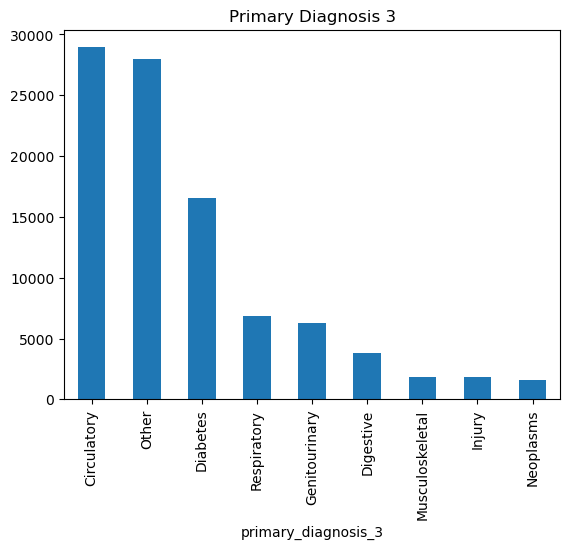

In [26]:

clean_df['primary_diagnosis_3'] = clean_df['diag_3'].apply(categorize_primary_diagnosis)
print(clean_df.primary_diagnosis_3.value_counts())
clean_df.primary_diagnosis_3.value_counts().plot(kind="bar")
plt.title("Primary Diagnosis 3")

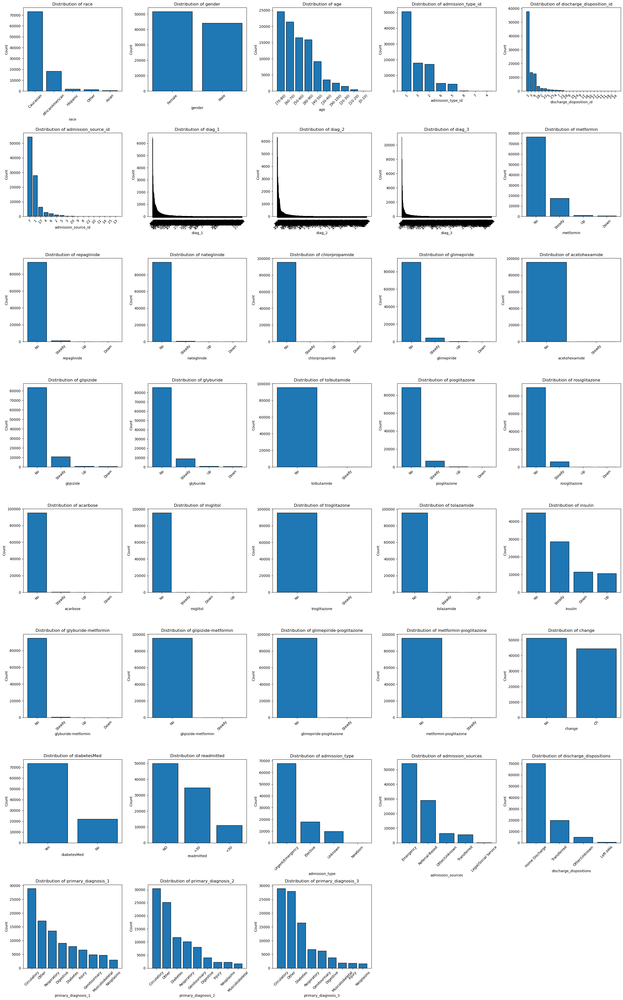

In [28]:
# Looking for all categorical data's value distribution
def plot_categorical_distributions(dataframe):
    # Select columns with 'object' or 'category' dtype
    categorical_columns = dataframe.select_dtypes(include=['object', 'category']).columns
    
    n = len(categorical_columns)
    ncols = 5
    nrows = math.ceil(n / ncols)
    
    # Create a figure and a grid of subplots
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5*ncols, 5*nrows))
    axes = axes.flatten() if isinstance(axes, (list, np.ndarray)) else [axes]
    for i, col in enumerate(categorical_columns):
        value_counts = dataframe[col].value_counts()
        axes[i].bar(value_counts.index.astype(str), value_counts.values, edgecolor='black')
        axes[i].set_title(f"Distribution of {col}")
        axes[i].set_xlabel(col)
        axes[i].set_ylabel("Count")
        axes[i].tick_params(axis='x', rotation=45)

    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

plot_categorical_distributions(clean_df)

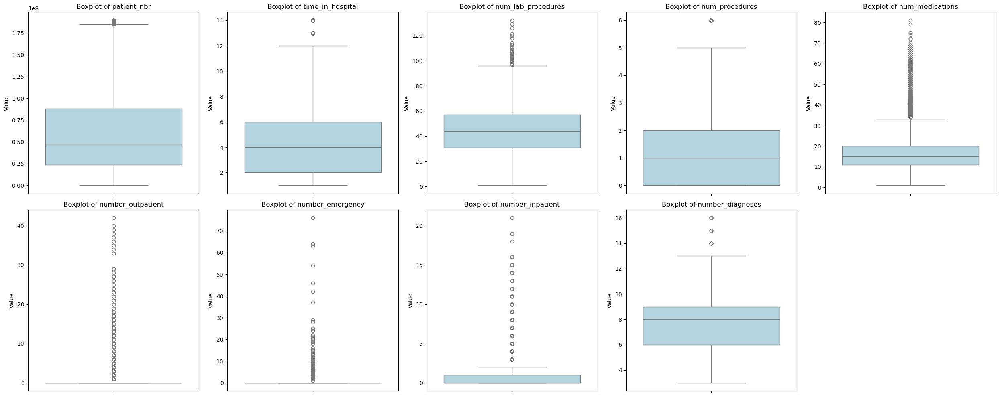

In [29]:
# Visualize numerical features for outlier detection
def plot_numerical_boxplots(dataframe):
    numerical_columns = dataframe.select_dtypes(include=['number']).columns  # Select numerical columns
    
    n = len(numerical_columns)
    ncols = 5 
    nrows = (n // ncols) + (n % ncols > 0)  

    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5 * ncols, 5 * nrows))
    axes = axes.flatten()  

    for i, col in enumerate(numerical_columns):
        sns.boxplot(y=dataframe[col], ax=axes[i], color="lightblue")
        axes[i].set_title(f"Boxplot of {col}")
        axes[i].set_ylabel("Value")
    
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
        
    plt.tight_layout()
    plt.show()
        
plot_numerical_boxplots(clean_df)
# Please disregard patient_nbr

# Might need to apply log transformation or any other standardization since data is significantly skewed
# Apply log transformation to highly skewed variables (number_outpatient, number_emergency, num_medications).
# Standardize or normalize num_lab_procedures, num_medications, and num_procedures to improve model performance.

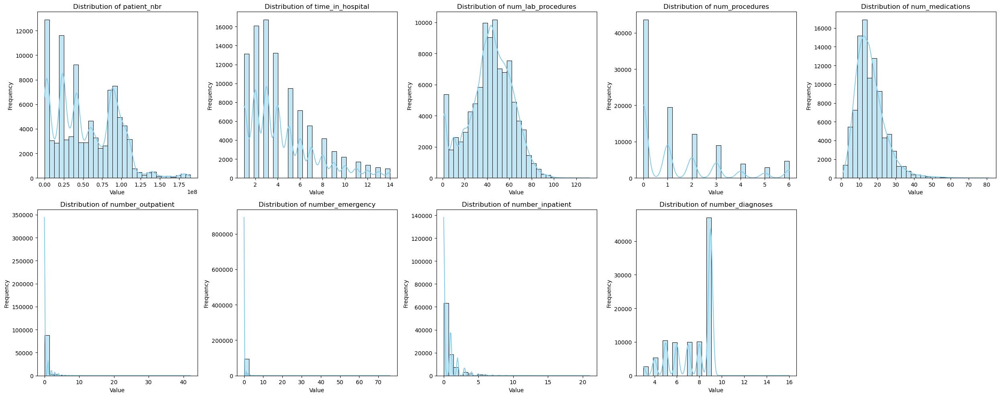

In [30]:
def plot_numerical_distributions(dataframe):
    numerical_columns = dataframe.select_dtypes(include=['number']).columns
    
    n = len(numerical_columns)
    ncols = 5
    nrows = (n // ncols) + (n % ncols > 0)

    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5 * ncols, 5 * nrows))
    axes = axes.flatten()

    for i, col in enumerate(numerical_columns):
        sns.histplot(dataframe[col], bins=30, kde=True, ax=axes[i], color="skyblue")
        axes[i].set_title(f"Distribution of {col}")
        axes[i].set_xlabel("Value")
        axes[i].set_ylabel("Frequency")

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()
plot_numerical_distributions(clean_df)

In [32]:
# Investigate outliers using IQR
def detect_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Get outliers
    outliers = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    
    return outliers

# Finding outliers in 'num_medications'
outliers_num_medications = detect_outliers_iqr(clean_df, "num_medications")
outliers_num_medications

# Will come back to this later

,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,...,metformin-pioglitazone,change,diabetesMed,readmitted,admission_type,admission_sources,discharge_dispositions,primary_diagnosis_1,primary_diagnosis_2,primary_diagnosis_3
149,1741662,Caucasian,Male,[70-80),6,25,7,8,61,2,...,No,Ch,Yes,>30,Unknown,Emergency,Other/Unknown,Digestive,Digestive,Circulatory
336,442341,Caucasian,Male,[30-40),6,25,4,12,103,4,...,No,Ch,Yes,NO,Unknown,Transferred,Other/Unknown,Respiratory,Circulatory,Diabetes
361,3656088,Caucasian,Female,[60-70),1,1,7,8,77,4,...,No,No,Yes,>30,Urgent/Emergency,Emergency,Home Discharge,Circulatory,Respiratory,Other
411,78047901,Caucasian,Male,[50-60),2,1,4,8,76,6,...,No,Ch,Yes,NO,Urgent/Emergency,Transferred,Home Discharge,Circulatory,Circulatory,Respiratory
466,5193639,Caucasian,Female,[50-60),2,1,4,10,71,6,...,No,Ch,Yes,NO,Urgent/Emergency,Transferred,Home Discharge,Circulatory,Circulatory,Injury
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101572,44946270,Caucasian,Male,[50-60),1,1,7,4,41,3,...,No,Ch,Yes,>30,Urgent/Emergency,Emergency,Home Discharge,Circulatory,Circulatory,Circulatory
101587,141485063,AfricanAmerican,Male,[20-30),1,1,7,12,101,6,...,No,Ch,Yes,NO,Urgent/Emergency,Emergency,Home Discharge,Diabetes,Circulatory,Musculoskeletal
101619,91263078,Caucasian,Female,[70-80),3,3,1,4,7,1,...,No,No,Yes,NO,Elective,Referral-Based,Transferred,Musculoskeletal,Other,Musculoskeletal
101716,93806559,Other,Male,[70-80),2,3,7,8,67,3,...,No,Ch,Yes,NO,Urgent/Emergency,Emergency,Transferred,Digestive,Diabetes,Other


In [33]:
final_df = clean_df.drop(columns=['patient_nbr', 'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'diag_1', 'diag_2', 'diag_3'])
final_df

,race,gender,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,...,metformin-pioglitazone,change,diabetesMed,readmitted,admission_type,admission_sources,discharge_dispositions,primary_diagnosis_1,primary_diagnosis_2,primary_diagnosis_3
1,Caucasian,Female,[10-20),3,59,0,18,0,0,0,...,No,Ch,Yes,>30,Urgent/Emergency,Emergency,Home Discharge,Other,Diabetes,Other
2,AfricanAmerican,Female,[20-30),2,11,5,13,2,0,1,...,No,No,Yes,NO,Urgent/Emergency,Emergency,Home Discharge,Other,Diabetes,Other
3,Caucasian,Male,[30-40),2,44,1,16,0,0,0,...,No,Ch,Yes,NO,Urgent/Emergency,Emergency,Home Discharge,Other,Diabetes,Circulatory
4,Caucasian,Male,[40-50),1,51,0,8,0,0,0,...,No,Ch,Yes,NO,Urgent/Emergency,Emergency,Home Discharge,Neoplasms,Neoplasms,Diabetes
5,Caucasian,Male,[50-60),3,31,6,16,0,0,0,...,No,No,Yes,>30,Urgent/Emergency,Referral-Based,Home Discharge,Circulatory,Circulatory,Diabetes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,AfricanAmerican,Male,[70-80),3,51,0,16,0,0,0,...,No,Ch,Yes,>30,Urgent/Emergency,Emergency,Transferred,Diabetes,Other,Circulatory
101762,AfricanAmerican,Female,[80-90),5,33,3,18,0,0,1,...,No,No,Yes,NO,Urgent/Emergency,Transferred,Transferred,Digestive,Other,Digestive
101763,Caucasian,Male,[70-80),1,53,0,9,1,0,0,...,No,Ch,Yes,NO,Urgent/Emergency,Emergency,Home Discharge,Other,Genitourinary,Other
101764,Caucasian,Female,[80-90),10,45,2,21,0,0,1,...,No,Ch,Yes,NO,Urgent/Emergency,Emergency,Transferred,Injury,Other,Injury


In [27]:
clean_df.to_parquet('cleaned_hospital_readmission.parquet')

## Feature Importance
Trying with two methods;
- Filter: SelectKBest with Mutual Information 
- Wrapper: Recursive Feature Elimination (RFE)

In [34]:
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest, mutual_info_classif

#label encode first since most of our categorical data is in string format
categorical_features = final_df.select_dtypes(include=['object', 'category']).columns

# Apply Label Encoding to categorical features
label_encoders = {}
for col in categorical_features:
    le = LabelEncoder()
    final_df[col] = le.fit_transform(final_df[col])
    label_encoders[col] = le

X = final_df.drop("readmitted", axis=1)  # Drop the target variable
y = final_df["readmitted"]

selector = SelectKBest(score_func=mutual_info_classif, k=30)  # Select top 10 features
X_selected = selector.fit_transform(X, y)

# Get selected feature names
selected_features = X.columns[selector.get_support()]
print("Selected Features:", selected_features)

Selected Features: Index(['race', 'gender', 'age', 'time_in_hospital', 'num_medications',
       'number_outpatient', 'number_emergency', 'number_inpatient',
       'number_diagnoses', 'metformin', 'repaglinide', 'nateglinide',
       'chlorpropamide', 'glimepiride', 'glipizide', 'glyburide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'insulin',
       'glyburide-metformin', 'change', 'diabetesMed', 'admission_type',
       'admission_sources', 'discharge_dispositions', 'primary_diagnosis_1',
       'primary_diagnosis_2', 'primary_diagnosis_3'],
      dtype='object')


In [35]:
feature_scores = pd.DataFrame({
    "Feature": X.columns,
    "Score": selector.scores_
})

feature_scores = feature_scores.sort_values(by="Score", ascending=False)
feature_scores

,Feature,Score
9,number_inpatient,0.035263
22,acarbose,0.012032
15,glimepiride,0.011445
27,glyburide-metformin,0.010938
8,number_emergency,0.010659
10,number_diagnoses,0.010431
23,miglitol,0.010338
13,nateglinide,0.009126
32,diabetesMed,0.009093
11,metformin,0.008409


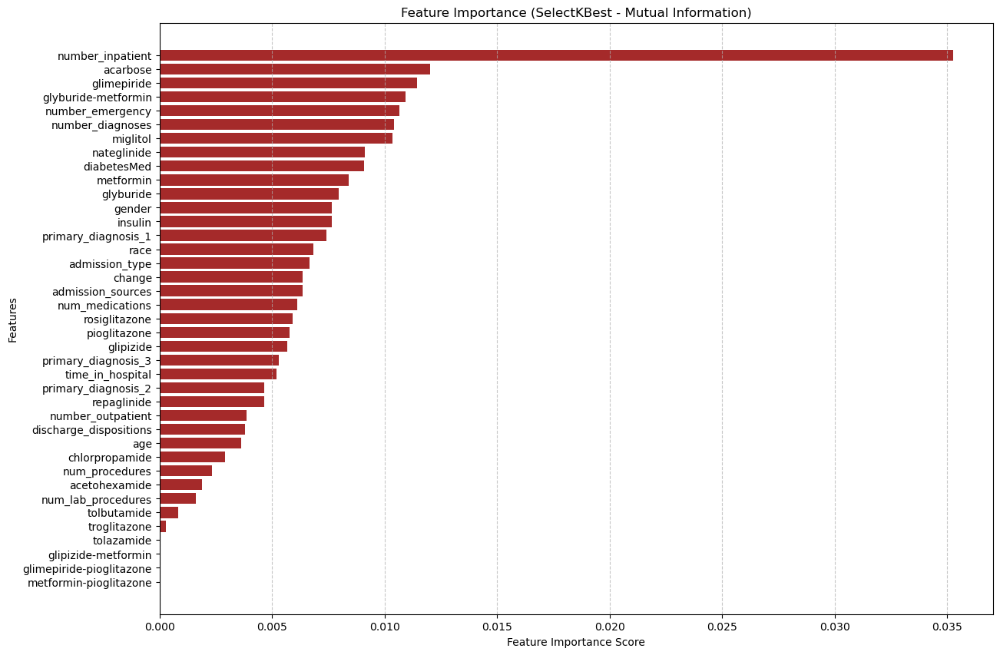

In [50]:
plt.figure(figsize=(14, 10))
y_positions = range(len(feature_scores))  # Custom y positions for spacing
plt.barh(y_positions, feature_scores["Score"], color="brown", height=0.8)  
plt.yticks(y_positions, feature_scores["Feature"])  # Manually set feature labels
plt.xlabel("Feature Importance Score")
plt.ylabel("Features")
plt.title("Feature Importance (SelectKBest - Mutual Information)")
plt.gca().invert_yaxis()
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.show()


In [36]:
# Further reduce dimensionality using Wrapper Method
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
filter_selected_features = ['race', 'gender', 'age', 'time_in_hospital', 'num_medications',
       'number_outpatient', 'number_emergency', 'number_inpatient',
       'number_diagnoses', 'metformin', 'repaglinide', 'nateglinide',
       'chlorpropamide', 'glimepiride', 'glipizide', 'glyburide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'insulin',
       'glyburide-metformin', 'change', 'diabetesMed', 'admission_type',
       'admission_sources', 'discharge_dispositions', 'primary_diagnosis_1',
       'primary_diagnosis_2', 'primary_diagnosis_3']

X_1st_reduced = final_df[filter_selected_features]

model = RandomForestClassifier()
rfe = RFE(model, n_features_to_select=15)  # Select top 15 features
X_rfe = rfe.fit_transform(X_1st_reduced, y)

# Show selected features
rfe_selected_features = X_1st_reduced.columns[rfe.support_]
print(rfe_selected_features)


Index(['race', 'gender', 'age', 'time_in_hospital', 'num_medications',
       'number_outpatient', 'number_inpatient', 'number_diagnoses',
       'metformin', 'glipizide', 'insulin', 'admission_sources',
       'primary_diagnosis_1', 'primary_diagnosis_2', 'primary_diagnosis_3'],
      dtype='object')


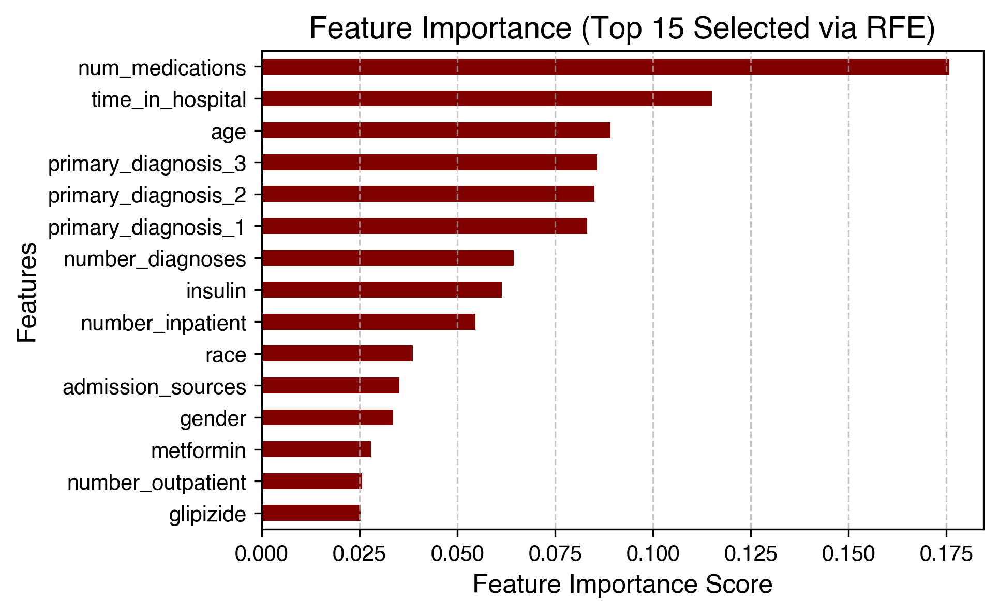

In [38]:
# Extract feature rankings and importance
feature_importance = pd.Series(rfe.ranking_, index=X_1st_reduced.columns)
selected_features = feature_importance[feature_importance == 1].index

# Fit a new RandomForest model to the reduced feature set for importance scores
model.fit(X_1st_reduced[selected_features], y)
importances = pd.Series(model.feature_importances_, index=selected_features)

# Sort features by importance
importances = importances.sort_values(ascending=True)

# Plot feature importance
plt.figure(figsize=(6, 4), dpi=300)
importances.plot(kind='barh', color='#800000')
plt.xlabel("Feature Importance Score", fontsize=12, fontname="Helvetica")
plt.ylabel("Features", fontsize=12, fontname="Helvetica")
plt.title("Feature Importance (Top 15 Selected via RFE)", fontsize=14, fontname="Helvetica", fontweight='bold')
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.xticks(fontsize=10, fontname="Helvetica")
plt.yticks(fontsize=10, fontname="Helvetica")
plt.show()

In [60]:
rfe_feature_scores = pd.DataFrame({
    "Feature": X_1st_reduced.columns,
    "Ranking": rfe.ranking_
})
rfe_feature_scores = rfe_feature_scores.sort_values(by="Ranking", ascending=True)
rfe_feature_scores

,Feature,Ranking
0,race,1
27,admission_sources,1
26,admission_type,1
22,insulin,1
15,glyburide,1
9,metformin,1
8,number_diagnoses,1
14,glipizide,1
29,primary_diagnosis,1
5,number_outpatient,1


## Class Imbalance

In [63]:
# Deal with class imbalance
